<a href="https://colab.research.google.com/github/Yang-HA-03/AI-lab/blob/main/Audio/Audio_SpeechRecognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install yt-dlp ffmpeg

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.9/175.9 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 59.7 MB/s eta 0:00:00
  Created wheel for ffmpeg: filename=ffmpeg-1.4-py3-none-any.whl size=6083 sha256=1437dd88692abeebfcc5141e33199e53b282cf4680a579563276d5e85b5b98ef
  Stored in directory: /root/.cache/pip/wheels/26/21/0c/c26e09dff860a9071683e279445262346e008a9a1d2142c4ad
Successfully built ffmpeg


In [2]:
!yt-dlp -x --audio-format wav "https://www.youtube.com/shorts/3BpEwpoa6kA" -o "my_youtube_audio.%(ext)s"


[youtube] Extracting URL: https://www.youtube.com/shorts/3BpEwpoa6kA
[youtube] 3BpEwpoa6kA: Downloading webpage
[youtube] 3BpEwpoa6kA: Downloading tv client config
[youtube] 3BpEwpoa6kA: Downloading tv player API JSON
[youtube] 3BpEwpoa6kA: Downloading web safari player API JSON
[youtube] 3BpEwpoa6kA: Downloading player 0004de42-main
[youtube] 3BpEwpoa6kA: Downloading m3u8 information
[info] 3BpEwpoa6kA: Downloading 1 format(s): 251
[download] Destination: my_youtube_audio.webm
[download] 100% of  234.50KiB in 00:00:00 at 1.22MiB/s
[ExtractAudio] Destination: my_youtube_audio.wav
Deleting original file my_youtube_audio.webm (pass -k to keep)


In [3]:
!ls


my_youtube_audio.wav  sample_data


In [4]:
import torchaudio

waveform, sample_rate = torchaudio.load("my_youtube_audio.wav")
print(waveform.shape, sample_rate)


torch.Size([2, 776290]) 48000


/usr/local/lib/python3.12/dist-packages/torchaudio/_backend/utils.py:213: UserWarning: In 2.9, this function's implementation will be changed to use torchaudio.load_with_torchcodec` under the hood. Some parameters like ``normalize``, ``format``, ``buffer_size``, and ``backend`` will be ignored. We recommend that you port your code to rely directly on TorchCodec's decoder instead: https://docs.pytorch.org/torchcodec/stable/generated/torchcodec.decoders.AudioDecoder.html#torchcodec.decoders.AudioDecoder.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchaudio/_backend/ffmpeg.py:88: UserWarning: torio.io._streaming_media_decoder.StreamingMediaDecoder has been deprecated. This deprecation is part of a large refactoring effort to transition TorchAudio into a maintenance phase. The decoding and encoding capabilities of PyTorch for both audio and video are being consolidated into TorchCodec. Please see https://github.com/pytorch/audio/issues/3902 for more information. It will be r

In [6]:
import torch
import torchaudio

print(torch.__version__)
print(torchaudio.__version__)

torch.random.manual_seed(0)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

print(device)

2.8.0+cu126
2.8.0+cu126
cpu


In [7]:
import IPython
import matplotlib.pyplot as plt
from torchaudio.utils import download_asset

SPEECH_FILE = download_asset("tutorial-assets/Lab41-SRI-VOiCES-src-sp0307-ch127535-sg0042.wav")

/tmp/ipython-input-499805210.py:5: UserWarning: torchaudio.utils.download.download_asset has been deprecated. This deprecation is part of a large refactoring effort to transition TorchAudio into a maintenance phase. Please see https://github.com/pytorch/audio/issues/3902 for more information. It will be removed from the 2.9 release. 
  SPEECH_FILE = download_asset("tutorial-assets/Lab41-SRI-VOiCES-src-sp0307-ch127535-sg0042.wav")
100%|██████████| 106k/106k [00:00<00:00, 13.0MB/s]


In [8]:
bundle = torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H

print("Sample Rate:", bundle.sample_rate)

print("Labels:", bundle.get_labels())

Sample Rate: 16000
Labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')


In [9]:
model = bundle.get_model().to(device)

print(model.__class__)

Downloading: "https://download.pytorch.org/torchaudio/models/wav2vec2_fairseq_base_ls960_asr_ls960.pth" to /root/.cache/torch/hub/checkpoints/wav2vec2_fairseq_base_ls960_asr_ls960.pth


100%|██████████| 360M/360M [00:01<00:00, 315MB/s]


<class 'torchaudio.models.wav2vec2.model.Wav2Vec2Model'>


In [10]:
SPEECH_FILE = "my_youtube_audio.wav"
import IPython.display as ipd
ipd.Audio(SPEECH_FILE)


In [11]:
!yt-dlp -x --audio-format wav \
"https://www.youtube.com/shorts/3BpEwpoa6kA" \
--postprocessor-args "-ss 00:00:00 -to 00:00:05" \
-o "my_youtube_audio_short.%(ext)s"


[youtube] Extracting URL: https://www.youtube.com/shorts/3BpEwpoa6kA
[youtube] 3BpEwpoa6kA: Downloading webpage
[youtube] 3BpEwpoa6kA: Downloading tv client config
[youtube] 3BpEwpoa6kA: Downloading tv player API JSON
[youtube] 3BpEwpoa6kA: Downloading web safari player API JSON
[youtube] 3BpEwpoa6kA: Downloading m3u8 information
[info] 3BpEwpoa6kA: Downloading 1 format(s): 251
[download] Sleeping 3.00 seconds as required by the site...
[download] Destination: my_youtube_audio_short.webm
[download] 100% of  234.50KiB in 00:00:00 at 1.25MiB/s
[ExtractAudio] Destination: my_youtube_audio_short.wav
Deleting original file my_youtube_audio_short.webm (pass -k to keep)


In [12]:
import IPython.display as ipd
import torchaudio

SPEECH_FILE = "my_youtube_audio_short.wav"

ipd.Audio(SPEECH_FILE)

waveform, sample_rate = torchaudio.load(SPEECH_FILE)
print(waveform.shape, sample_rate)


torch.Size([2, 239664]) 48000


In [13]:
SPEECH_FILE = "my_youtube_audio.wav"
import IPython.display as ipd
ipd.Audio(SPEECH_FILE)


In [14]:
SPEECH_FILE = "my_youtube_audio_short.wav"   # 짧게 자른 버전
import IPython.display as ipd

ipd.Audio(SPEECH_FILE)


In [15]:
SPEECH_FILE = "my_youtube_audio_short.wav"
waveform, sample_rate = torchaudio.load(SPEECH_FILE)
waveform = waveform.to(device)

if sample_rate != bundle.sample_rate:
    waveform = torchaudio.functional.resample(waveform, sample_rate, bundle.sample_rate)


In [16]:
with torch.inference_mode():
    features, _ = model.extract_features(waveform)

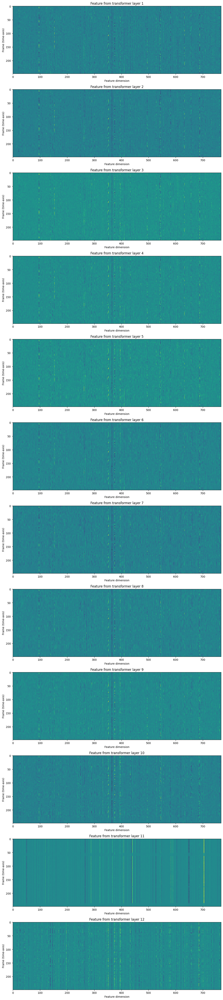

In [17]:
fig, ax = plt.subplots(len(features), 1, figsize=(16, 4.3 * len(features)))
for i, feats in enumerate(features):
    ax[i].imshow(feats[0].cpu(), interpolation="nearest")
    ax[i].set_title(f"Feature from transformer layer {i+1}")
    ax[i].set_xlabel("Feature dimension")
    ax[i].set_ylabel("Frame (time-axis)")
fig.tight_layout()

In [18]:
ax[i].imshow(feats[0].cpu(), interpolation="nearest", cmap="magma")


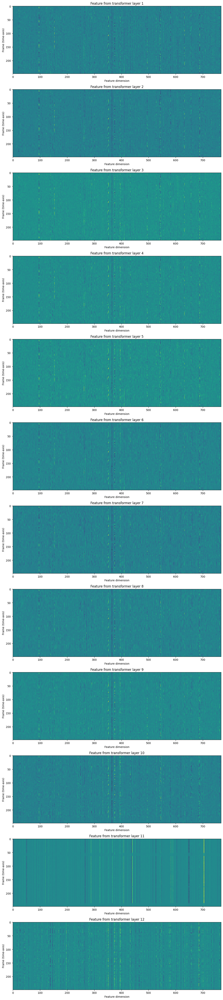

In [19]:
fig, ax = plt.subplots(len(features), 1, figsize=(16, 4.3 * len(features)))
for i, feats in enumerate(features):
    ax[i].imshow(feats[0].cpu(), interpolation="nearest")
    ax[i].set_title(f"Feature from transformer layer {i+1}")
    ax[i].set_xlabel("Feature dimension")
    ax[i].set_ylabel("Frame (time-axis)")
fig.tight_layout()

In [22]:
print(waveform.shape, sample_rate)


torch.Size([2, 79888]) 48000


In [23]:
for i, f in enumerate(features):
    print(i, f.shape)


0 torch.Size([2, 249, 768])
1 torch.Size([2, 249, 768])
2 torch.Size([2, 249, 768])
3 torch.Size([2, 249, 768])
4 torch.Size([2, 249, 768])
5 torch.Size([2, 249, 768])
6 torch.Size([2, 249, 768])
7 torch.Size([2, 249, 768])
8 torch.Size([2, 249, 768])
9 torch.Size([2, 249, 768])
10 torch.Size([2, 249, 768])
11 torch.Size([2, 249, 768])


In [24]:
with torch.inference_mode():
    emission, _ = model(waveform)

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')


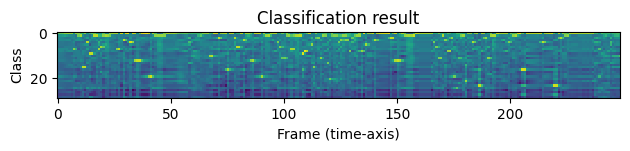

In [25]:
plt.imshow(emission[0].cpu().T, interpolation="nearest")
plt.title("Classification result")
plt.xlabel("Frame (time-axis)")
plt.ylabel("Class")
plt.tight_layout()
print("Class labels:", bundle.get_labels())

In [26]:
class GreedyCTCDecoder(torch.nn.Module):
    def __init__(self, labels, blank=0):
        super().__init__()
        self.labels = labels
        self.blank = blank

    def forward(self, emission: torch.Tensor) -> str:
        """Given a sequence emission over labels, get the best path string
        Args:
          emission (Tensor): Logit tensors. Shape `[num_seq, num_label]`.

        Returns:
          str: The resulting transcript
        """
        indices = torch.argmax(emission, dim=-1)  # [num_seq,]
        indices = torch.unique_consecutive(indices, dim=-1)
        indices = [i for i in indices if i != self.blank]
        return "".join([self.labels[i] for i in indices])

In [27]:
decoder = GreedyCTCDecoder(labels=bundle.get_labels())
transcript = decoder(emission[0])

In [28]:
print(transcript)
IPython.display.Audio(SPEECH_FILE)

I|WAS|IN|ITALY|A|RECENTLY|AND|I|SHOWED|UP|AT|THE|HOTEL|AND|THEY'D|BAKED|A|CAKE|IAR


In [29]:
model = torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H.get_model()
emission = model(waveform)

In [31]:
class GreedyCTCDecoder(torch.nn.Module):
    def __init__(self, labels, blank=0):
        super().__init__()
        self.labels = labels
        self.blank = blank

    def forward(self, emission: torch.Tensor) -> str:
        """Given a sequence emission over labels, get the best path string"""
        indices = torch.argmax(emission, dim=-1)
        indices = torch.unique_consecutive(indices, dim=-1)
        indices = indices.cpu().numpy().tolist()
        indices = [i for i in indices if i != self.blank]
        return "".join([self.labels[i] for i in indices])


In [34]:
class GreedyCTCDecoder(torch.nn.Module):
    def __init__(self, labels, blank=0):
        super().__init__()
        self.labels = labels
        self.blank = blank

    def forward(self, emission: torch.Tensor) -> str:
        """Given a sequence emission over labels, get the best path string"""
        indices = torch.argmax(emission, dim=-1)
        indices = torch.unique_consecutive(indices, dim=-1)
        indices = indices.cpu().numpy().tolist()


        if isinstance(indices[0], list):
            indices = indices[0]

        indices = [i for i in indices if i != self.blank]
        return "".join([self.labels[i] for i in indices])


In [35]:
decoder = GreedyCTCDecoder(labels=bundle.get_labels())
transcript = decoder(emission[0].cpu())
print("Predicted text:", transcript)


Predicted text: I|WAS|IN|ITALY|A|RECENTLY|AND|II|SHOWED|UP|AT|TTHE|HOTEL|AND|THEY'D|BAKED|A|CAKKE|IAR
